In [1]:
#main data file and import script for class group 6  project 1
# Author AO ottoaara@gmail.com. 952.693.1378 
# 5.5.23
# data source mpls open data https://opendata.minneapolismn.gov/datasets/cityoflakes::crime-data/explore?location=19.216823%2C-46.664577%2C4.00
# CSV option under Crime Data Header
import pandas as pd
import csv
import json
import matplotlib as pyplot
import geopandas as gpd
from shapely.geometry import Point, Polygon
import cartopy.crs as ccrs
import geoviews as gv #noqa
import pyproj
import hvplot.pandas

#crime_data_main  = full data set (75 Megs so seperated out into groups for ease of dev)
#ran_crime_data_df is a light 1000 rows of data randomly choosen from crime_data_man to work with
#crime_data_2019 = data for 2019 
#crime_data_2020 ...
#crime_data_2021 ...
#crime_data_2022...
##crime_data_2023 = data for 2023 
filename = "Crime_Data.csv"
csvdatapath = "Data/" + filename

In [2]:
# download local from repo to desktop (clone to your desktop)
#this reads the csv file 
crime_data_main = pd.read_csv(csvdatapath)

In [3]:
crime_data_main2 = crime_data_main.head (100)
crime_data_main2

,X,Y,Type,Case_Number,Case_NumberAlt,Reported_Date,Occurred_Date,NIBRS_Crime_Against,NIBRS_Group,NIBRS_Code,...,Address,Precinct,Neighborhood,Ward,Latitude,Longitude,wgsXAnon,wgsYAnon,Crime_Count,OBJECTID
0,-93.266383,44.967168,Additional Crime Metrics,19-004242,MP20194242,2019/01/05 02:50:00+00,2019/01/05 01:19:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0006XX 16TH ST E,1.0,Elliot Park,6.0,44.96717,-93.26638,-1.038237e+07,5.616354e+06,1,1
1,-93.293230,45.033891,Additional Crime Metrics,19-011769,MP201911769,2019/01/12 19:33:00+00,2019/01/12 17:40:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0043XX DUPONT AVE N,4.0,Webber - Camden,4.0,45.03389,-93.29323,-1.038535e+07,5.626859e+06,1,2
2,-93.250318,44.968899,Additional Crime Metrics,19-013490,MP201913490,2019/01/14 20:23:00+00,2018/12/31 12:00:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0015XX 6TH ST S,1.0,Cedar Riverside,6.0,44.96890,-93.25032,-1.038058e+07,5.616627e+06,1,3
3,-93.294961,45.018555,Additional Crime Metrics,19-026246,MP201926246,2019/01/27 18:23:00+00,2019/01/26 00:15:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0012XX 35TH AVE N,4.0,Folwell,4.0,45.01855,-93.29496,-1.038555e+07,5.624443e+06,1,4
4,-93.294961,45.018555,Additional Crime Metrics,19-026853,MP201926853,2019/01/28 17:45:00+00,2019/01/28 11:00:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0012XX 35TH AVE N,4.0,Folwell,4.0,45.01855,-93.29496,-1.038555e+07,5.624443e+06,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,-93.274033,44.964585,Additional Crime Metrics,19-018994,MP201918994,2019/01/20 02:40:00+00,2019/01/19 23:38:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0018XX 2ND AVE S,5.0,Steven's Square - Loring Heights,6.0,44.96459,-93.27403,-1.038322e+07,5.615948e+06,1,96
96,-93.218565,44.967887,Additional Crime Metrics,19-001533,MP20191533,2019/01/02 14:55:00+00,2019/01/02 14:15:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0001XX WILLIAMS AVE SE,2.0,Prospect Park - East River Road,2.0,44.96789,-93.21856,-1.037704e+07,5.616467e+06,1,97
97,-93.301225,45.035447,Additional Crime Metrics,19-004892,MP20194892,2019/01/05 19:40:00+00,2019/01/05 19:40:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0016XX 44TH AVE N,4.0,Webber - Camden,4.0,45.03545,-93.30123,-1.038624e+07,5.627104e+06,1,98
98,-93.268356,44.944983,Additional Crime Metrics,19-006510,MP20196510,2019/01/07 16:26:00+00,2019/01/07 16:26:00+00,Non NIBRS Data,Non NIBRS Data,Non NIBRS Data,...,0005XX 32ND ST E,3.0,Central,9.0,44.94498,-93.26836,-1.038259e+07,5.612864e+06,1,99


In [4]:
#columns listed for ease of co-development use. 
crime_data_main.columns

Index(['X', 'Y', 'Type', 'Case_Number', 'Case_NumberAlt', 'Reported_Date',
       'Occurred_Date', 'NIBRS_Crime_Against', 'NIBRS_Group', 'NIBRS_Code',
       'Offense_Category', 'Offense', 'Problem_Initial', 'Problem_Final',
       'Address', 'Precinct', 'Neighborhood', 'Ward', 'Latitude', 'Longitude',
       'wgsXAnon', 'wgsYAnon', 'Crime_Count', 'OBJECTID'],
      dtype='object')

In [5]:
#checkign data types 
crime_data_main.dtypes

X                      float64
Y                      float64
Type                    object
Case_Number             object
Case_NumberAlt          object
Reported_Date           object
Occurred_Date           object
NIBRS_Crime_Against     object
NIBRS_Group             object
NIBRS_Code              object
Offense_Category        object
Offense                 object
Problem_Initial         object
Problem_Final           object
Address                 object
Precinct               float64
Neighborhood            object
Ward                   float64
Latitude               float64
Longitude              float64
wgsXAnon               float64
wgsYAnon               float64
Crime_Count              int64
OBJECTID                 int64
dtype: object

In [6]:
crime_data_main['Occurred_Date'] = pd.to_datetime(crime_data_main['Occurred_Date'])

In [7]:
#get count of one column to prep for null value check 
crime_data_main["X"].count()

226833

In [8]:
# Remove rows containing all null values- cleaning data set
crime_data_clean = crime_data_main.dropna(how='any')

In [9]:
# removing rows with null values.  
crime_data_clean["X"].count()

152154

In [10]:
# checking values of crime category to reduce our data set down further to violent crimes 
crime_data_clean["Offense_Category"].unique()

array(['Subset of NIBRS Assault Offenses', 'Drug/Narcotic Offenses ',
       'Burglary/Breaking & Entering ', 'Assault Offenses ',
       'Larceny/Theft Offenses ', 'Stolen Property Offenses ',
       'Fraud Offenses ', 'Animal Cruelty ', 'Motor Vehicle Theft ',
       'Sex Offenses ', 'Robbery ', 'Kidnapping/Abduction ',
       'Weapon Law Violations ', 'Embezzlement ',
       'Pornography/Obscene Material ', 'Subset of NIBRS Robbery',
       'Counterfeiting/Forgery ', 'Arson ', 'Prostitution Offenses ',
       'Destruction/Damage/Vandalism of Property ',
       'Extortion/Blackmail ', 'Homicide Offenses ', 'Human Trafficking ',
       'Bribery ', 'Gambling Offenses ', 'Gunshot Wound Victims',
       'Shots Fired Calls'], dtype=object)

In [11]:
# reducing the data sets to only have violent crimes in them.  Note Included motor vehicle theft due to the
# high volumme of car-jackings occuring in mpls. 

crime_categories = [
    #'Subset of NIBRS Assault Offenses',
    'Assault Offenses ',
    #'Larceny/Theft Offenses ',
    'Sex Offenses ',
    'Robbery ',
    #'Burglary/Breaking & Entering ',
    #'Motor Vehicle Theft ',
    #'Weapon Law Violations ',
    'Kidnapping/Abduction ',
    'Homicide Offenses ',
    'Human Trafficking ',
    'Gunshot Wound Victims ',
    #'Shots Fired Calls'
]

#crime_data_clean = crime_data_clean[crime_data_clean['Offense_Category'].isin(crime_categories)]


In [12]:
#changing Occured_Date filed to data/time from object
crime_data_clean['Occurred_Date'] = pd.to_datetime(crime_data_clean['Occurred_Date'])


C:\Users\12182\AppData\Local\Temp\ipykernel_10784\2250024751.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_clean['Occurred_Date'] = pd.to_datetime(crime_data_clean['Occurred_Date'])


In [13]:
#checking to make sure date/time conv worked 
crime_data_clean.dtypes

X                                  float64
Y                                  float64
Type                                object
Case_Number                         object
Case_NumberAlt                      object
Reported_Date                       object
Occurred_Date          datetime64[ns, UTC]
NIBRS_Crime_Against                 object
NIBRS_Group                         object
NIBRS_Code                          object
Offense_Category                    object
Offense                             object
Problem_Initial                     object
Problem_Final                       object
Address                             object
Precinct                           float64
Neighborhood                        object
Ward                               float64
Latitude                           float64
Longitude                          float64
wgsXAnon                           float64
wgsYAnon                           float64
Crime_Count                          int64
OBJECTID   

In [14]:
#building random data set 
# n_samples = min(1000, len(crime_data_clean))
# ran_crime_data_df = crime_data_clean.sample(n=n_samples, random_state=42)

In [15]:
#crime_data_2019["Offense_Category"].unique()

In [16]:
#building year data sets
crime_data_2019 = crime_data_main[crime_data_main['Occurred_Date'].dt.year == 2019]

crime_data_2020 = crime_data_main[crime_data_main['Occurred_Date'].dt.year == 2020]

crime_data_2021 = crime_data_main[crime_data_main['Occurred_Date'].dt.year == 2021]

crime_data_2022 = crime_data_main[crime_data_main['Occurred_Date'].dt.year == 2022]

crime_data_2023 = crime_data_main[crime_data_main['Occurred_Date'].dt.year == 2023]

#crime_data_2022.dtypes

#crime_data_2020['Occurred_Date'].unique()

#crime_data_2023['Offense_Category'].unique()

#len(crime_data_2019),len(crime_data_2020), len(crime_data_2021),len(crime_data_2022),len(crime_data_2023)

In [17]:
#reducing data sets to viloent crimes
crime_data_2019 = crime_data_2019[crime_data_2019['Offense_Category'].isin(crime_categories)]

crime_data_2020 = crime_data_2020[crime_data_2020['Offense_Category'].isin(crime_categories)]

crime_data_2021 = crime_data_2021[crime_data_2021['Offense_Category'].isin(crime_categories)]

crime_data_2022 = crime_data_2022[crime_data_2022['Offense_Category'].isin(crime_categories)]

crime_data_2023 = crime_data_2023[crime_data_2023['Offense_Category'].isin(crime_categories)]

len(crime_data_2019), len(crime_data_2020), len(crime_data_2021), len(crime_data_2022)

#crime_data_2022["Offense_Category"].unique()
#crime_data_2022['Occurred_Date'].unique()
#crime_data_2022['Offense_Category']

(10298, 10555, 10478, 10741)

In [18]:
crime_data_2019.dtypes

X                                  float64
Y                                  float64
Type                                object
Case_Number                         object
Case_NumberAlt                      object
Reported_Date                       object
Occurred_Date          datetime64[ns, UTC]
NIBRS_Crime_Against                 object
NIBRS_Group                         object
NIBRS_Code                          object
Offense_Category                    object
Offense                             object
Problem_Initial                     object
Problem_Final                       object
Address                             object
Precinct                           float64
Neighborhood                        object
Ward                               float64
Latitude                           float64
Longitude                          float64
wgsXAnon                           float64
wgsYAnon                           float64
Crime_Count                          int64
OBJECTID   

In [19]:
# grouping with smaller data set to look at where the crimes are happening - counting number of offenses 
#grouped_data = crime_data_clearn.groupby(['Neighborhood', 'Address']).size().reset_index(name='Offense_Count')
grouped_data = crime_data_clean.groupby(['Neighborhood', 'Address', 'Offense_Category']).size().reset_index(name='Offense_Count')


In [20]:
#sorting grouped data to show the worst parts of town ie sorting by places more than one offense occurred
sorted_grouped_data = grouped_data.sort_values(by='Offense_Count', ascending=False)


In [21]:
# viewing sorted data frame. 
sorted_grouped_data

,Neighborhood,Address,Offense_Category,Offense_Count
27722,Northeast Park,0014XX NEW BRIGHTON BLVD,Larceny/Theft Offenses,491
18710,Longfellow,0025XX LAKE ST E,Larceny/Theft Offenses,362
12545,Hawthorne,0021XX ALDRICH AVE N,Assault Offenses,347
7196,Downtown West,0009XX NICOLLET MALL,Larceny/Theft Offenses,311
8519,East Phillips,0024XX 18TH AVE S,Assault Offenses,309
...,...,...,...,...
18248,Linden Hills,0040XX QUEEN AVE S,Assault Offenses,1
18247,Linden Hills,0040XX LINDEN HILLS BLVD,Motor Vehicle Theft,1
18246,Linden Hills,0040XX LINDEN HILLS BLVD,Larceny/Theft Offenses,1
18245,Linden Hills,0040XX LINDEN HILLS BLVD,Burglary/Breaking & Entering,1


In [22]:
# adding in date time to support further analysis to check correlation between time and offense
grouped_data_bydate = crime_data_clean.groupby(['Neighborhood', 'Address', 'Offense_Category', 'Occurred_Date']).size().reset_index(name='Offense_Count')


In [23]:
grouped_data_bydate

,Neighborhood,Address,Offense_Category,Occurred_Date,Offense_Count
0,Armatage,0019XX 60TH ST W,Larceny/Theft Offenses,2021-08-25 10:00:00+00:00,1
1,Armatage,0020XX 60TH ST W,Motor Vehicle Theft,2020-06-08 22:45:00+00:00,1
2,Armatage,0021XX 53RD ST W,Assault Offenses,2019-06-29 19:00:00+00:00,1
3,Armatage,0021XX 53RD ST W,Assault Offenses,2019-07-08 15:29:00+00:00,1
4,Armatage,0021XX 53RD ST W,Assault Offenses,2020-06-25 00:00:00+00:00,1
...,...,...,...,...,...
150825,Windom Park,18HALF AVE NE / POLK ST NE,Motor Vehicle Theft,2023-04-18 20:23:00+00:00,1
150826,Windom Park,19TH AVE NE / GARFIELD ST NE,Motor Vehicle Theft,2023-01-04 23:00:00+00:00,1
150827,Windom Park,22ND AVE NE / ULYSSES ST NE,Motor Vehicle Theft,2023-05-07 15:00:00+00:00,1
150828,Windom Park,24TH AVE NE / FILLMORE ST NE,Larceny/Theft Offenses,2023-03-24 22:27:00+00:00,1


In [24]:
# viewing sorted data frame. 
sorted_grouped_data = grouped_data_bydate.sort_values(by='Offense_Count', ascending=False)
sorted_grouped_data

,Neighborhood,Address,Offense_Category,Occurred_Date,Offense_Count
25024,Downtown West,0009XX 4TH ST S,Pornography/Obscene Material,2021-01-30 00:00:00+00:00,37
25019,Downtown West,0009XX 4TH ST S,Pornography/Obscene Material,2020-01-30 00:00:00+00:00,26
22954,Downtown West,0005XX 4TH AVE S,Pornography/Obscene Material,2021-01-30 00:00:00+00:00,18
53156,Holland,0007XX 23RD AVE NE,Destruction/Damage/Vandalism of Property,2023-02-22 01:00:00+00:00,11
8193,Central,0004XX LAKE ST E,Robbery,2020-05-28 00:05:00+00:00,9
...,...,...,...,...,...
50515,Hawthorne,0028XX PACIFIC ST,Destruction/Damage/Vandalism of Property,2021-06-16 20:35:00+00:00,1
50516,Hawthorne,0028XX PACIFIC ST,Destruction/Damage/Vandalism of Property,2022-09-16 16:00:00+00:00,1
50517,Hawthorne,0028XX PACIFIC ST,Destruction/Damage/Vandalism of Property,2022-11-05 12:30:00+00:00,1
50518,Hawthorne,0028XX PACIFIC ST,Larceny/Theft Offenses,2023-02-03 08:00:00+00:00,1


In [25]:
# adding long and lat. for analysis by location 
crime_data_byLongLat = grouped_data_bydate.merge(
    crime_data_clean[['Neighborhood', 'Address', 'Latitude', 'Longitude']],
    on=['Neighborhood', 'Address'],
    how='left')

In [26]:
crime_data_byLongLat

,Neighborhood,Address,Offense_Category,Occurred_Date,Offense_Count,Latitude,Longitude
0,Armatage,0019XX 60TH ST W,Larceny/Theft Offenses,2021-08-25 10:00:00+00:00,1,44.89430,-93.30421
1,Armatage,0020XX 60TH ST W,Motor Vehicle Theft,2020-06-08 22:45:00+00:00,1,44.89431,-93.30545
2,Armatage,0021XX 53RD ST W,Assault Offenses,2019-06-29 19:00:00+00:00,1,44.90693,-93.30675
3,Armatage,0021XX 53RD ST W,Assault Offenses,2019-06-29 19:00:00+00:00,1,44.90693,-93.30675
4,Armatage,0021XX 53RD ST W,Assault Offenses,2019-06-29 19:00:00+00:00,1,44.90693,-93.30675
...,...,...,...,...,...,...,...
20206857,Windom Park,22ND AVE NE / ULYSSES ST NE,Motor Vehicle Theft,2023-05-07 15:00:00+00:00,1,45.00959,-93.23588
20206858,Windom Park,24TH AVE NE / FILLMORE ST NE,Larceny/Theft Offenses,2023-03-24 22:27:00+00:00,1,45.01219,-93.24224
20206859,Windom Park,24TH AVE NE / FILLMORE ST NE,Larceny/Theft Offenses,2023-03-24 22:27:00+00:00,1,45.01219,-93.24224
20206860,Windom Park,24TH AVE NE / FILLMORE ST NE,Stolen Property Offenses,2023-03-24 22:27:00+00:00,1,45.01219,-93.24224


In [27]:
#display 2019 crime data
crime_data_2019["Type"].unique()

array(['Crime Offenses (NIBRS)'], dtype=object)

In [28]:
#Configure plot map for 2019
map_plot_2019 = crime_data_2019.hvplot.points(
    "Longitude",
    "Latitude",
    geo = True, 
    tiles = True, 
    frame_width = 600,
    frame_height = 600,
    c = "Offense_Category"
)

#Display the map plot
map_plot_2019

#len(crime_data_2019)


:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]   (Offense_Category)

In [29]:
#Configure plot map for 2020
map_plot_2020 = crime_data_2020.hvplot.points(
    "Longitude",
    "Latitude",
    geo = True, 
    tiles = True, 
    frame_width = 600,
    frame_height = 600,
    c = "Offense_Category"
    
)

#Display the map plot
map_plot_2020

#len(crime_data_2020)

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]   (Offense_Category)

In [30]:
#Configure plot map for 2021
map_plot_2021 = crime_data_2021.hvplot.points(
    "Longitude",
    "Latitude",
    geo = True, 
    tiles = True, 
    frame_width = 600,
    frame_height = 600,
    c = "Offense_Category"
)

#Display the map plot
map_plot_2021

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]   (Offense_Category)

In [31]:
#Configure plot map for 2022
map_plot_2022 = crime_data_2022.hvplot.points(
    "Longitude",
    "Latitude",
    geo = True, 
    tiles = True, 
    frame_width = 600,
    frame_height = 600,
    c = "Offense_Category"
)

#Display the map plot
map_plot_2022

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]   (Offense_Category)

In [32]:
#Configure plot map for 2023
map_plot_2023 = crime_data_2023.hvplot.points(
    "Longitude",
    "Latitude",
    geo = True, 
    tiles = True, 
    frame_width = 600,
    frame_height = 600,
    c = "Offense_Category"
)

#Display the map plot
map_plot_2023

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]   (Offense_Category)

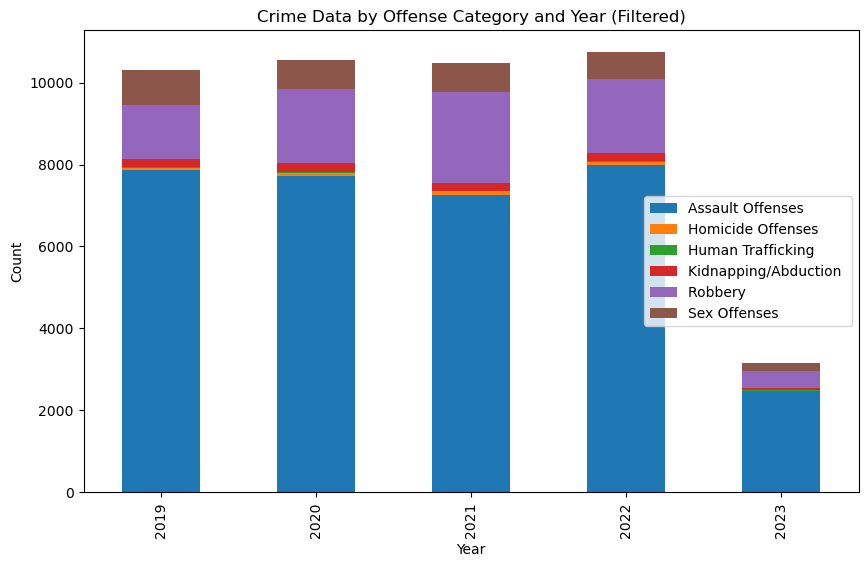

In [33]:

import matplotlib.pyplot as plt

# Filter the DataFrame to include only offense categories found in crime_categories
crime_data_filtered = crime_data_main[crime_data_main['Offense_Category'].isin(crime_categories)]

# Filter the DataFrame to include only rows with occurred dates between 2019 and 2023
crime_data_filtered = crime_data_filtered[(crime_data_filtered['Occurred_Date'].dt.year >= 2019) & (crime_data_filtered['Occurred_Date'].dt.year <= 2023)]

# Extract the year from 'Occurred_Date' and create a new column
crime_data_filtered['Year'] = crime_data_filtered['Occurred_Date'].dt.year

# Group the filtered data by 'Year' and 'Offense_Category' and count the occurrences
grouped_data = crime_data_filtered.groupby(['Year', 'Offense_Category']).size().reset_index(name='Count')

# Pivot the data to have 'Year' as the index, 'Offense_Category' as the columns, and 'Count' as the values
pivot_data = grouped_data.pivot(index='Year', columns='Offense_Category', values='Count')

# Plot the pivot_data as a stacked bar chart
pivot_data.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend()
plt.show()



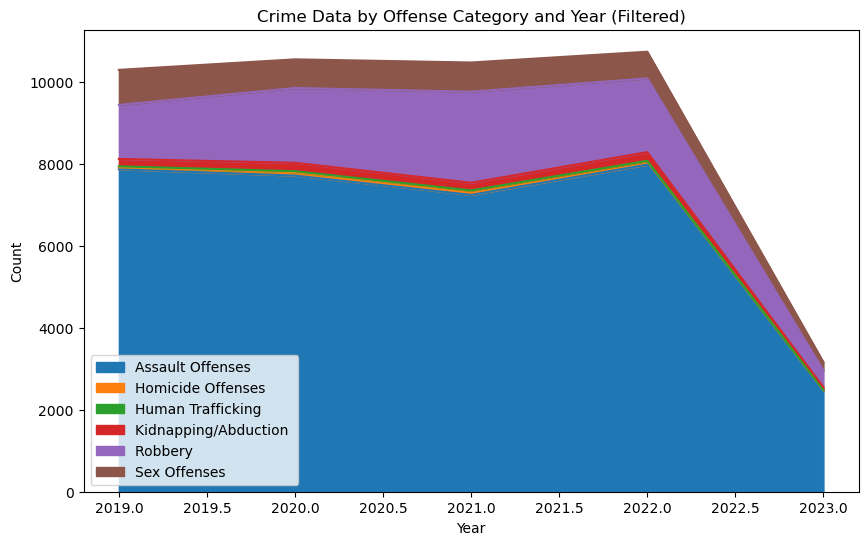

In [34]:
pivot_data.plot(kind='area', figsize=(10, 6))
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend()
plt.show()

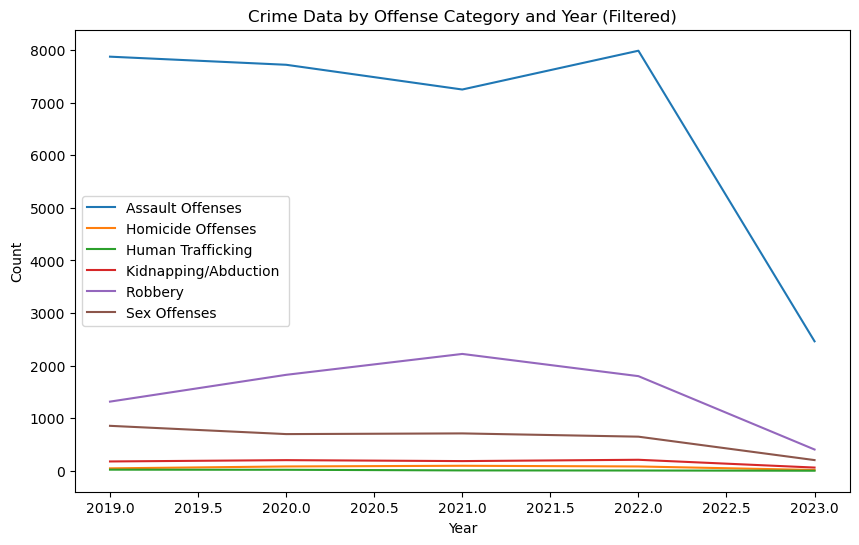

In [35]:
pivot_data.plot(kind='line', figsize=(10, 6))
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend()
plt.show()

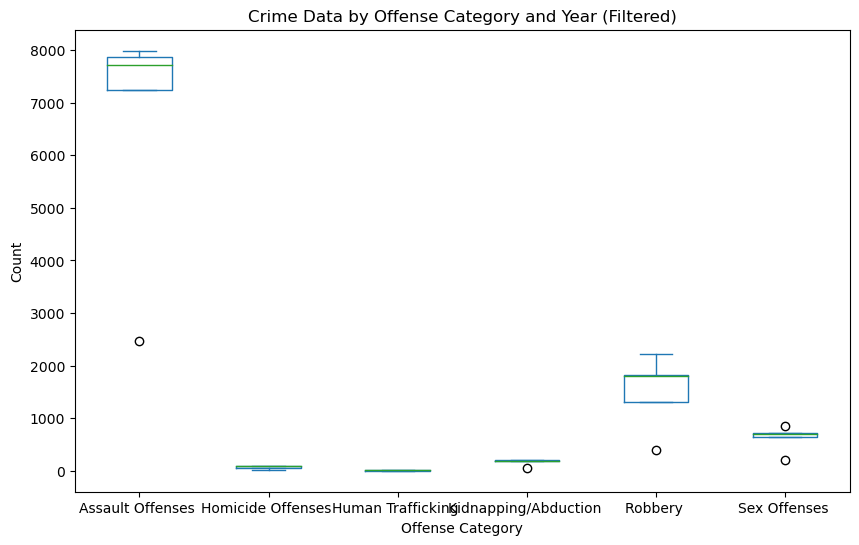

In [36]:
pivot_data.plot(kind='box', figsize=(10, 6))
plt.xlabel('Offense Category')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.show()

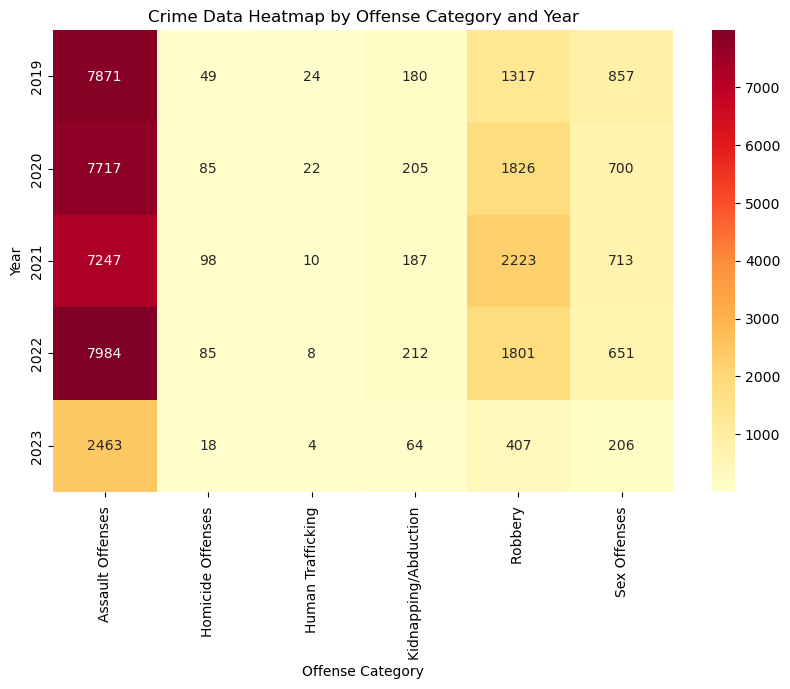

In [37]:
# bringin seaborn
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_data, cmap='YlOrRd', annot=True, fmt='d', cbar=True)
plt.xlabel('Offense Category')
plt.ylabel('Year')
plt.title('Crime Data Heatmap by Offense Category and Year')
plt.show()


In [38]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook

# Enable Bokeh for Jupyter Notebook
output_notebook()

# Create a scatter plot using Bokeh
p = figure(title='Crime Data Heatmap', x_axis_label='Longitude', y_axis_label='Latitude')
p.scatter(crime_data_main['Longitude'], crime_data_main['Latitude'], color='red')

# Show the plot
show(p)


Loading BokehJS ...

In [39]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.palettes import Category10

output_notebook()

# Create a Bokeh figure
p = figure(plot_height=400, plot_width=800, title='Crime Data by Offense Category and Year (Filtered)', toolbar_location=None,
           x_axis_label='Year', y_axis_label='Count')

# Create a list of colors for each offense category
colors = Category10[len(pivot_data.columns)]

# Plot lines for each offense category
for category, color in zip(pivot_data.columns, colors):
    p.line(pivot_data.index, pivot_data[category], line_color=color, legend_label=category)

# Add a legend
p.legend.location = 'top_left'

show(p)


Loading BokehJS ...

In [40]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.palettes import Category10
from bokeh.models import Legend

output_notebook()

# Create a Bokeh figure
p = figure(x_range=list(map(str, pivot_data.index)), plot_height=400, plot_width=800,
           title='Crime Data by Offense Category and Year (Filtered)', toolbar_location=None,
           x_axis_label='Year', y_axis_label='Count')

# Create a list of colors for each offense category
colors = Category10[len(pivot_data.columns)]

# Plot stacked areas
areas = p.varea_stack(stackers=list(pivot_data.columns), x='Year', color=colors, source=pivot_data,
                      legend_label=list(pivot_data.columns))

# Create a legend
legend = Legend(items=[(category, [area]) for category, area in zip(pivot_data.columns, areas)], location='top_left')
p.add_layout(legend, 'right')

show(p)



Loading BokehJS ...

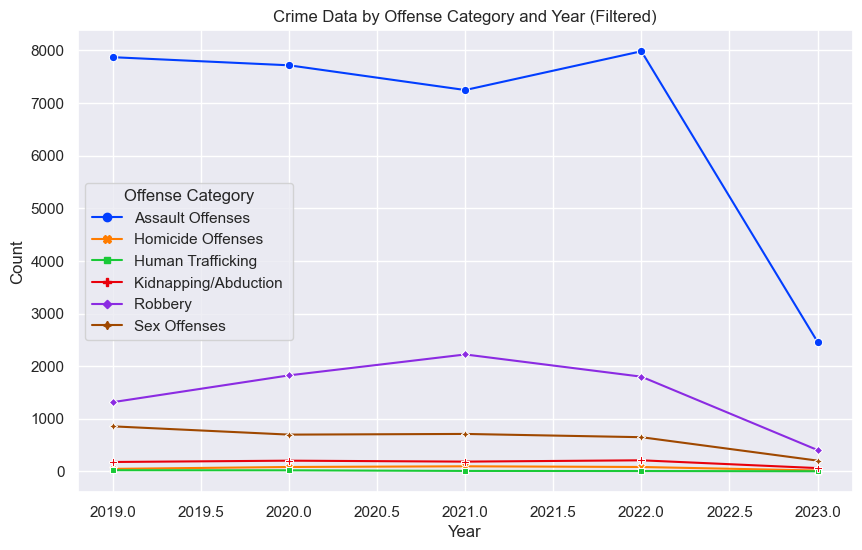

In [41]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set()

# Create a line chart using seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=pivot_data, dashes=False, markers=True, palette='bright')
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend(title='Offense Category')

plt.show()



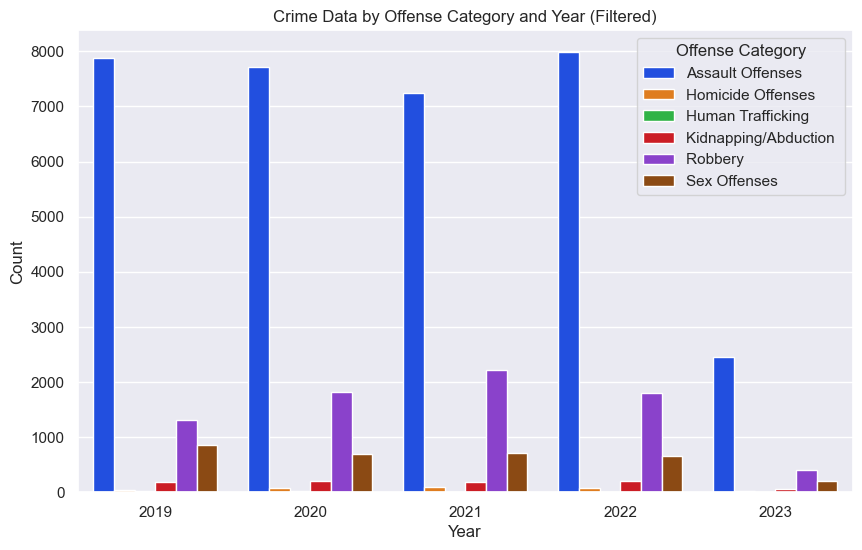

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set()

# Create a grouped bar chart using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=grouped_data, x='Year', y='Count', hue='Offense_Category', palette='bright')
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend(title='Offense Category')

plt.show()


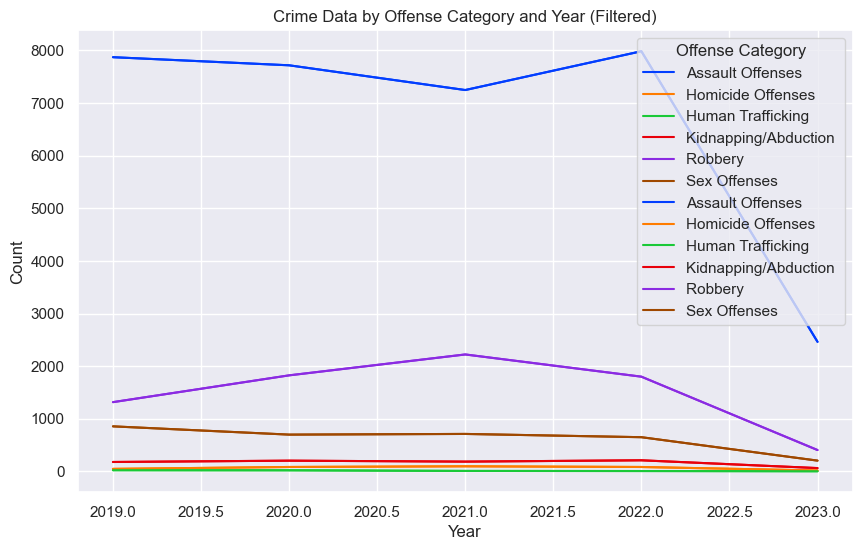

In [43]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set()

# Create an area chart using seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=pivot_data, dashes=False, markers=False, palette='bright')
sns.lineplot(data=pivot_data, dashes=False, markers=False, palette='bright', estimator=None)
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Crime Data by Offense Category and Year (Filtered)')
plt.legend(title='Offense Category')

plt.show()


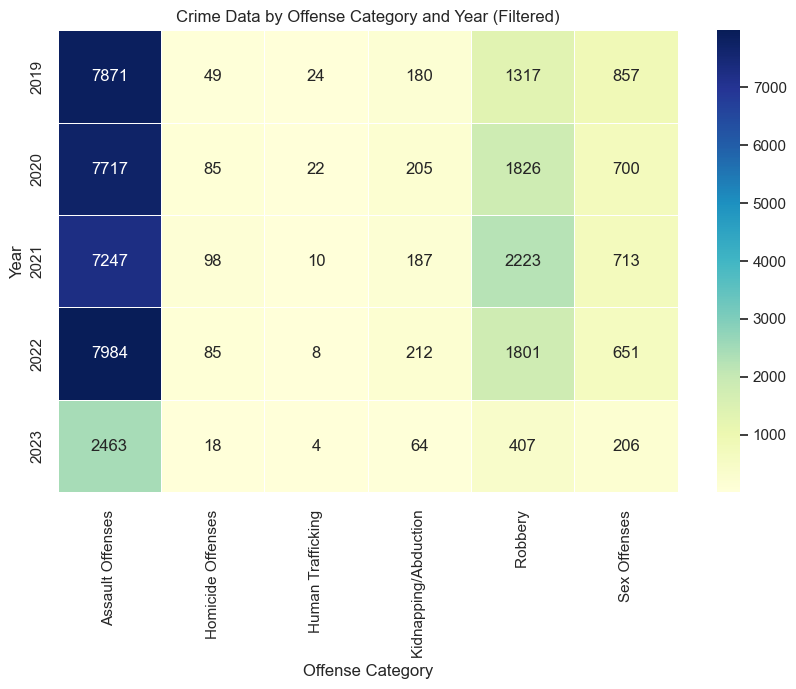

In [44]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set()

# Create a heatmap using seaborn
plt.figure(figsize=(10, 6))
sns.heatmap(data=pivot_data, cmap='YlGnBu', annot=True, fmt='d', linewidths=0.5)
plt.xlabel('Offense Category')
plt.ylabel('Year')
plt.title('Crime Data by Offense Category and Year (Filtered)')

plt.show()


<Axes: xlabel='Longitude', ylabel='Latitude'>

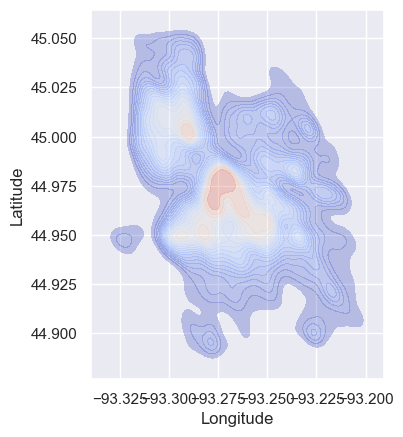

In [45]:
# Heat map
ax = plt.axes()
ax.set_aspect('equal')
sns.kdeplot(data=crime_data_clean,
            x='Longitude', 
            y='Latitude', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax
            )

In [46]:
my_data = crime_data_clean.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes = my_data.sort_values(by='Offense_Count', ascending=False)

# Test to see if resetting index affected the data - it didn't yep and yes the same
yes = yes.reset_index()
yep = yes[["Latitude", "Longitude", "Offense_Count"]]
yep

,Latitude,Longitude,Offense_Count
0,45.00364,-93.22883,491
1,44.94837,-93.23515,362
2,45.00086,-93.28952,345
3,44.97450,-93.27432,311
4,44.95824,-93.24859,307
...,...,...,...
42603,44.93323,-93.32264,1
42604,44.92262,-93.32865,1
42605,44.92874,-93.32843,1
42606,44.92874,-93.32843,1


<Axes: xlabel='Longitude', ylabel='Latitude'>

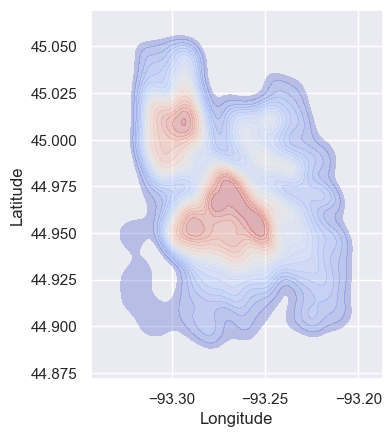

In [47]:
ax = plt.axes()
ax.set_aspect('equal')
sns.kdeplot(data=yes,
            x='Longitude', 
            y='Latitude', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax
            )

<Axes: xlabel='Longitude', ylabel='Latitude'>

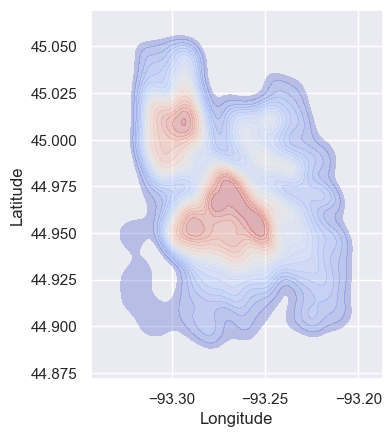

In [48]:
ax = plt.axes()
ax.set_aspect('equal')
sns.kdeplot(data=yep,
            x='Longitude', 
            y='Latitude', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax
            )

In [49]:
my_2019 = crime_data_2019.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes_2019 = my_2019.sort_values(by='Offense_Count', ascending=False)
yes_2019

,Neighborhood,Address,Offense_Category,Latitude,Longitude,Offense_Count
931,Hawthorne,0021XX ALDRICH AVE N,Assault Offenses,45.00086,-93.28952,92
464,Downtown West,0004XX 10TH ST N,Assault Offenses,44.97734,-93.27883,78
490,Downtown West,0004XX NICOLLET MALL,Assault Offenses,44.97928,-93.27020,76
1825,Near - North,0011XX NEWTON AVE N,Assault Offenses,44.98880,-93.30574,74
629,East Phillips,0024XX 18TH AVE S,Assault Offenses,44.95824,-93.24859,72
...,...,...,...,...,...,...
1715,Midtown Phillips,0025XX 10TH AVE S,Kidnapping/Abduction,44.95643,-93.26005,1
1714,Midtown Phillips,0025XX 10TH AVE S,Human Trafficking,44.95643,-93.26005,1
1712,Midtown Phillips,0024XX ELLIOT AVE,Assault Offenses,44.95822,-93.26130,1
1711,Midtown Phillips,0024XX CHICAGO AVE,Robbery,44.95822,-93.26258,1


<Axes: xlabel='Longitude', ylabel='Latitude'>

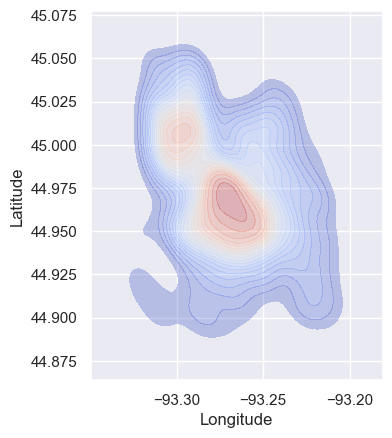

In [50]:
ax = plt.axes()
ax.set_aspect('equal')
sns.kdeplot(data=yes_2019,
            x='Longitude', 
            y='Latitude', 
            fill=True,
            cmap='coolwarm',
            alpha=0.3, 
            gridsize=200,
            levels=20,
            ax=ax
            )

In [51]:
my_2020 = crime_data_2020.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes_2020 = my_2020.sort_values(by='Offense_Count', ascending=False)
yes_2020

,Neighborhood,Address,Offense_Category,Latitude,Longitude,Offense_Count
1009,Hawthorne,0021XX ALDRICH AVE N,Assault Offenses,45.00086,-93.28952,98
668,East Phillips,0024XX 18TH AVE S,Assault Offenses,44.95824,-93.24859,89
1198,Jordan,0014XX 29TH AVE N,Assault Offenses,45.00957,-93.29747,66
576,Downtown West,0009XX NICOLLET MALL,Assault Offenses,44.97450,-93.27432,61
1933,McKinley,0035XX BRYANT AVE N,Assault Offenses,45.01942,-93.29056,61
...,...,...,...,...,...,...
1403,Lind - Bohanon,0046XX COLFAX AVE N,Assault Offenses,45.03936,-93.29272,1
1404,Lind - Bohanon,0046XX EMERSON AVE N,Assault Offenses,45.03935,-93.29526,1
1409,Lind - Bohanon,0047XX 6TH ST N,Assault Offenses,45.04121,-93.28758,1
1412,Lind - Bohanon,0047XX COLFAX AVE N,Assault Offenses,45.04118,-93.29273,1


In [67]:
my_2021 = crime_data_2021.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes_2021 = my_2021.sort_values(by='Offense_Count', ascending=False)
yes_2021.head(20)

,Neighborhood,Address,Offense_Category,Latitude,Longitude,Offense_Count
1091,Hawthorne,0021XX ALDRICH AVE N,Assault Offenses,45.00086,-93.28952,73
753,East Phillips,0024XX 18TH AVE S,Assault Offenses,44.95824,-93.24859,62
641,Downtown West,0009XX NICOLLET MALL,Assault Offenses,44.97450,-93.27432,62
560,Downtown West,0004XX 10TH ST N,Assault Offenses,44.97734,-93.27883,54
2903,Steven's Square - Loring Heights,0018XX 2ND AVE S,Assault Offenses,44.96459,-93.27403,52
3165,Webber - Camden,0040XX DUPONT AVE N,Assault Offenses,45.02858,-93.29319,51
1663,Loring Park,0015XX LASALLE AVE,Assault Offenses,44.96705,-93.27933,49
2899,Steven's Square - Loring Heights,0018XX 1ST AVE S,Assault Offenses,44.96458,-93.27658,47
1269,Jordan,0012XX 23RD AVE N,Assault Offenses,45.00261,-93.29640,47
1640,Loring Park,0013XX NICOLLET MALL,Assault Offenses,44.97052,-93.27774,46


In [53]:
my_2022 = crime_data_2022.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes_2022 = my_2022.sort_values(by='Offense_Count', ascending=False)
yes_2022

,Neighborhood,Address,Offense_Category,Latitude,Longitude,Offense_Count
515,Downtown West,0004XX 10TH ST N,Assault Offenses,44.97734,-93.27883,89
1051,Hawthorne,0021XX ALDRICH AVE N,Assault Offenses,45.00086,-93.28952,74
542,Downtown West,0004XX NICOLLET MALL,Assault Offenses,44.97928,-93.27020,69
705,East Phillips,0024XX 18TH AVE S,Assault Offenses,44.95824,-93.24859,66
590,Downtown West,0009XX NICOLLET MALL,Assault Offenses,44.97450,-93.27432,62
...,...,...,...,...,...,...
1386,Lind - Bohanon,0046XX HUMBOLDT AVE N,Assault Offenses,45.03824,-93.29908,1
1389,Lind - Bohanon,0047XX 6TH ST N,Assault Offenses,45.04121,-93.28758,1
1390,Lind - Bohanon,0047XX 6TH ST N,Homicide Offenses,45.04121,-93.28758,1
1391,Lind - Bohanon,0047XX ALDRICH AVE N,Assault Offenses,45.04119,-93.29016,1


In [54]:
my_2023 = crime_data_2023.groupby(['Neighborhood', 'Address', 'Offense_Category', "Latitude", "Longitude"]).size().reset_index(name='Offense_Count')
yes_2023 = my_2023.sort_values(by='Offense_Count', ascending=False)
yes_2023

,Neighborhood,Address,Offense_Category,Latitude,Longitude,Offense_Count
260,Downtown West,0004XX NICOLLET MALL,Assault Offenses,44.97928,-93.27020,26
777,Lowry Hill East,0028XX DUPONT AVE S,Assault Offenses,44.95100,-93.29317,24
342,East Phillips,0024XX 18TH AVE S,Assault Offenses,44.95824,-93.24859,23
1478,Whittier,0029XX PLEASANT AVE,Assault Offenses,44.94955,-93.28300,21
891,McKinley,0035XX BRYANT AVE N,Assault Offenses,45.01942,-93.29056,19
...,...,...,...,...,...,...
611,Jordan,FREMONT AVE N / BROADWAY AVE W,Assault Offenses,44.99916,-93.29564,1
610,Jordan,30TH AVE N / JAMES AVE N,Robbery,45.01139,-93.30064,1
609,Jordan,0029XX NEWTON AVE N,Assault Offenses,45.01052,-93.30570,1
608,Jordan,0029XX EMERSON AVE N,Assault Offenses,45.01043,-93.29433,1


In [55]:
import folium
from folium.plugins import HeatMap
# Create a Map instance
m = folium.Map(location=[45.00086, -93.28952], zoom_start=45)

# Create a list of data
heat_data = [[row['Latitude'], row['Longitude']] for index, row in crime_data_2019.iterrows()]
# Add the heatmap to the map instance
HeatMap(heat_data).add_to(m)
HeatMap(heat_data, max_opacity=0.001).add_to(m)  # adjust the value as needed
m

In [56]:
# Create a Map instance
m2 = folium.Map(location=[44.94837, -93.23515], radius=.001, zoom_start=50)

# Create a list of data
heat_data2 = [[row['Latitude'], row['Longitude']] for index, row in crime_data_clean.iterrows()]
# Add the heatmap to the map instance
HeatMap(heat_data2).add_to(m2)
HeatMap(heat_data2, max_opacity=0.001).add_to(m2)  # adjust the value as needed
m2

In [57]:
# Create a Map instance
m3 = folium.Map(location=[45.00086, -93.28952], radius=.001, zoom_start=50)

# Create a list of data
heat_data3 = [[row['Latitude'], row['Longitude']] for index, row in crime_data_2020.iterrows()]
# Add the heatmap to the map instance
HeatMap(heat_data3).add_to(m3)
HeatMap(heat_data3, max_opacity=0.0001).add_to(m3)  # adjust the value as needed
m3

In [65]:
# Create a Map instance
m4 = folium.Map(location=[45.00086, -93.28952], radius=.0000000000000000000000001, zoom_start=50)

# Create a list of data
heat_data4 = [[row['Latitude'], row['Longitude']] for index, row in crime_data_2021.iterrows()]
# Add the heatmap to the map instance
HeatMap(heat_data4).add_to(m4)
HeatMap(heat_data4, max_opacity=0.0001).add_to(m4)  # adjust the value as needed
m4

In [66]:
# Create a Map instance
m5 = folium.Map(location=[44.97734, -93.27883], radius=.00000001, zoom_start=50)

# Create a list of data
heat_data5 = [[row['Latitude'], row['Longitude']] for index, row in crime_data_2022.iterrows()]
# Add the heatmap to the map instance
HeatMap(heat_data5).add_to(m5)
HeatMap(heat_data5, max_opacity=0.0001).add_to(m5)  # adjust the value as needed
m4